# `Exploring the data`
Goal: To combine similar labels to decrease the number of classes

In [83]:
import pandas as pd 
import numpy as np
import seaborn as sn
import matplotlib.pyplot as plt
import seaborn as sns
import scipy as sp
import os
import json
import random
from PIL import Image
import IPython.display as display

In [84]:
df = pd.read_csv("trial_cleaning2.csv")

In [85]:
df.head()

,Unnamed: 0,name,object_classification,date,description,material,dynasty,path,location,period
0,0,ear-ring bead,ear-ring,1stc-3rdc,copper alloy ear-ring of thin wire with a loo...,copper alloy,NaN,bri_A_1880-3687-m.jpg,NaN,NaN
1,1,hair-pin dress-pin,hair-pin,1stc bc-early 1stc,copper alloy ornamental hair- or dress-pin he...,copper alloy,NaN,bri_A_1880-3711-o.jpg,NaN,NaN
2,2,hair-pin dress-pin,hair-pin,1stc bc-early 1stc,copper alloy ornamental hair- or dress-pin he...,copper alloy,NaN,bri_A_1880-3714-a.jpg,NaN,NaN
3,3,hair-pin dress-pin,hair-pin,1stc bc-early 1stc,copper alloy ornamental hair- or dress-pin he...,copper alloy,NaN,bri_A_1880-3717-f.jpg,NaN,NaN
4,4,ear-ring,ear-ring,1stc-3rdc,cast copper alloy hoop ear-ring bound with th...,copper alloy,NaN,bri_A_1880-3960.jpg,NaN,NaN


In [86]:
def print_value_count(df, col, range):
    x =df[col].value_counts()
    plt.figure(figsize=(12,8))
    plt.xticks(rotation=90)
    plt.bar(x = x.index[0:range] ,  height= x.values[0:range])
    return x.index[0:range]

In [87]:
import os

def find_path_image(value):
    base_path = os.path.join(os.getcwd(), os.pardir)
    if value[0:3] == 'bri':
        return os.path.join(base_path, 'BritishMuseum', 'photo', value)
    elif value[0:3] == 'glo':
        return os.path.join(base_path, 'GlobalEgyptianMuseum', 'photo', value)
    elif value[0:3] == 'met':
        return os.path.join(base_path, 'MetMuseum', 'photo', value)
    elif value[0:3] == 'ros':
        return os.path.join(base_path, 'RosicruicanMuseum', 'photo', value)
    else:
        return "error"

In [88]:
def show_images(df, col, equal, num_images_per_row=10, num_rows=4, label_fontsize=8):
    try:
       
        # Filter the DataFrame (for example, based on the 'Count' column)
        filtered_df = df[df[col] == equal]
        print(equal, len(filtered_df) )
        # Randomly select rows for the specified number of images
        num_images = num_images_per_row * num_rows
        random_sample = random.sample(range(len(filtered_df)), min(num_images, len(filtered_df)))
        selected_rows = filtered_df.iloc[random_sample]

        # Create a num_rows x num_images_per_row subplot grid
        fig, axes = plt.subplots(num_rows, num_images_per_row, figsize=(15, 3 * num_rows))

        # Display the images in the grid
        for i, (index, row) in enumerate(selected_rows.iterrows()):
            try:
                img_path = find_path_image(row['path'])
                img = Image.open(img_path)

                # Get the current subplot axes
                ax = axes[i // num_images_per_row, i % num_images_per_row]

                # Display the image and set the title as the image name with reduced font size
                ax.imshow(img)
                ax.set_title(row['path'], fontsize=label_fontsize)
                ax.axis('off')  # Turn off axis labels
            except Exception as img_load_error:
                print(f"Error loading image at index {index}: {img_load_error}")
                # If there's an error loading an image, display a placeholder or skip the current subplot
                ax = axes[i // num_images_per_row, i % num_images_per_row]
                ax.text(0.5, 0.5, "Image Error", ha='center', va='center', transform=ax.transAxes)
                ax.axis('off')  # Turn off axis labels

        # Adjust layout for better spacing
        plt.tight_layout()
        plt.show()
    except Exception as e:
        print("ERROR: " + str(e))

In [89]:
def combine_values(df, column_name, values_to_combine, new_value):
    """
    Combine specified values in a DataFrame column into a new value.

    Parameters:
    - df (pd.DataFrame): The DataFrame.
    - column_name (str): The name of the column to modify.
    - values_to_combine (list): A list of values to combine.
    - new_value (str): The new value to assign to the combined values.
    """
    df[column_name] = df[column_name].apply(lambda x: new_value if x in values_to_combine else x)

In [90]:
df.columns

Index(['Unnamed: 0', 'name', 'object_classification', 'date', 'description',
       'material', 'dynasty', 'path', 'location', 'period'],
      dtype='object')

## `Object Classification`

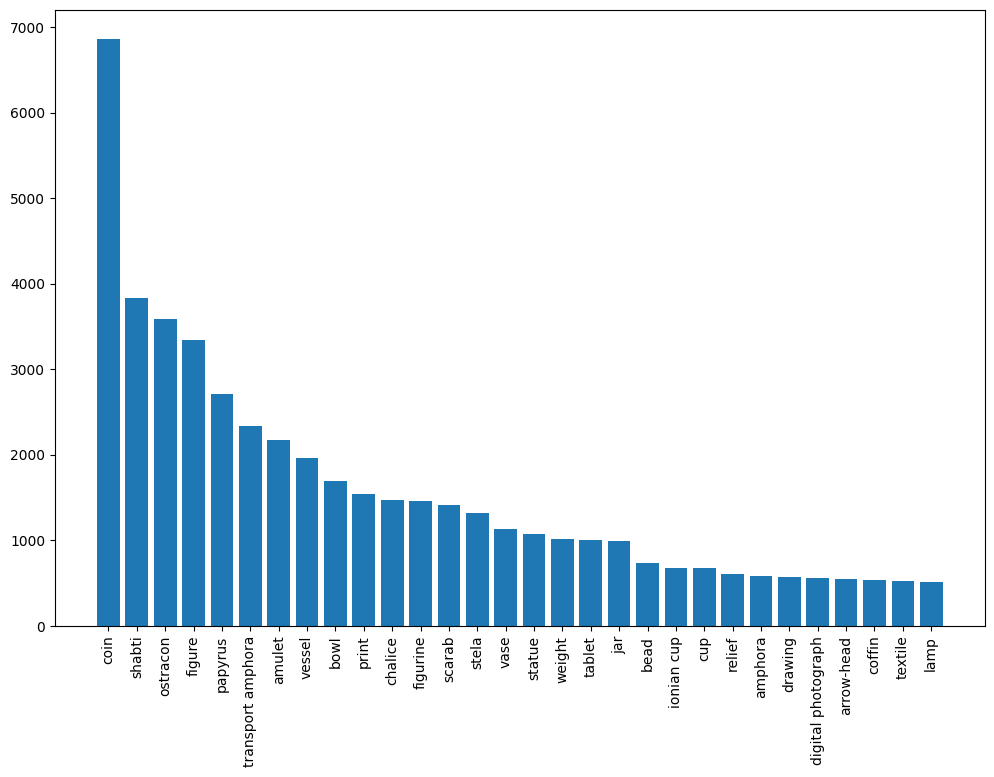

In [91]:
top30_pbject = print_value_count(df, "object_classification", 30)

### `Visualize the object types`

coin 6857


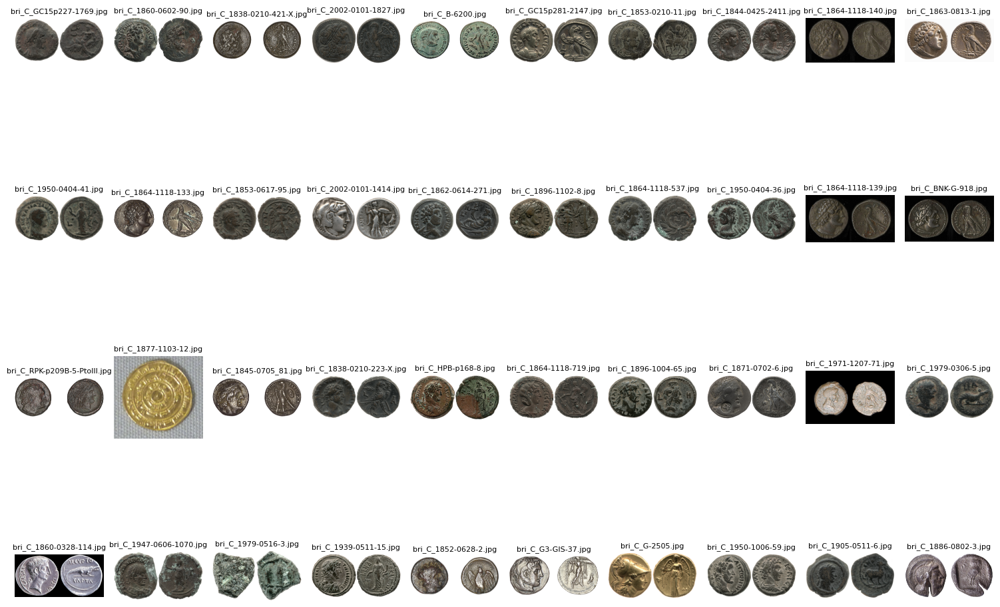

shabti 3837


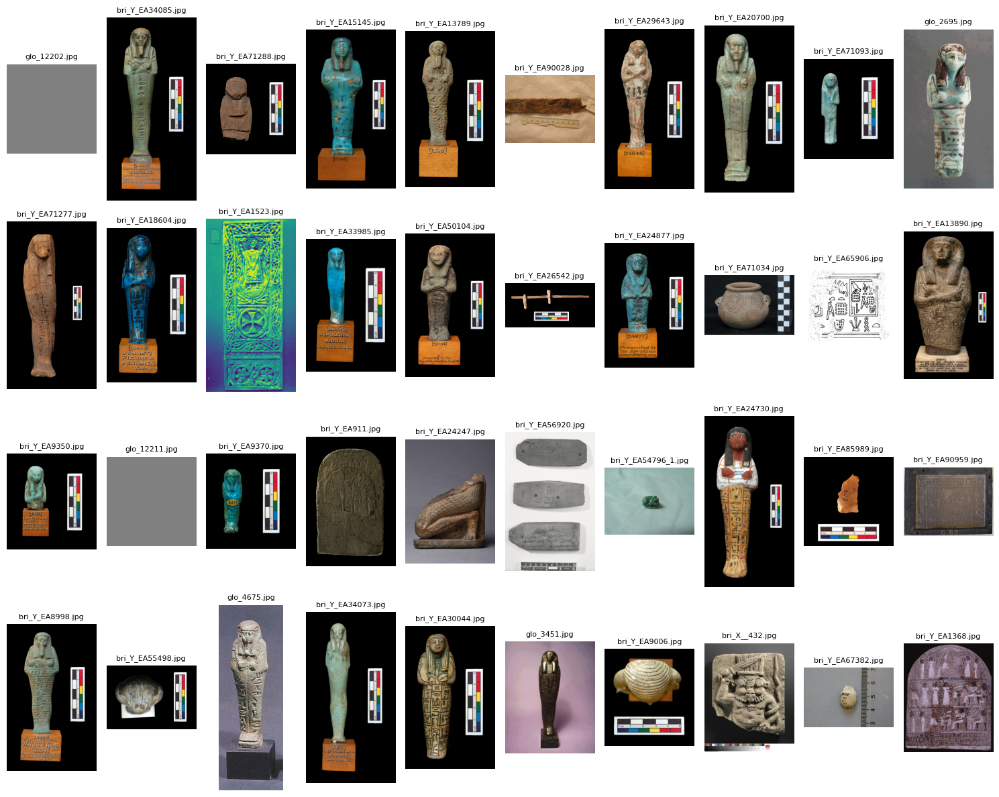

ostracon 3591


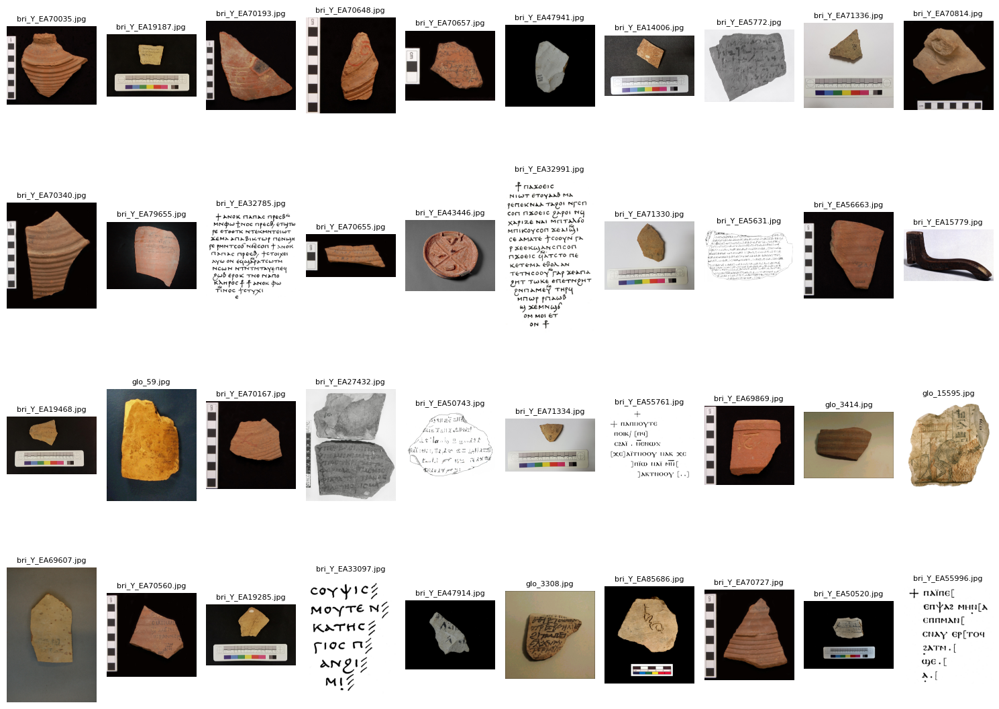

figure 3337


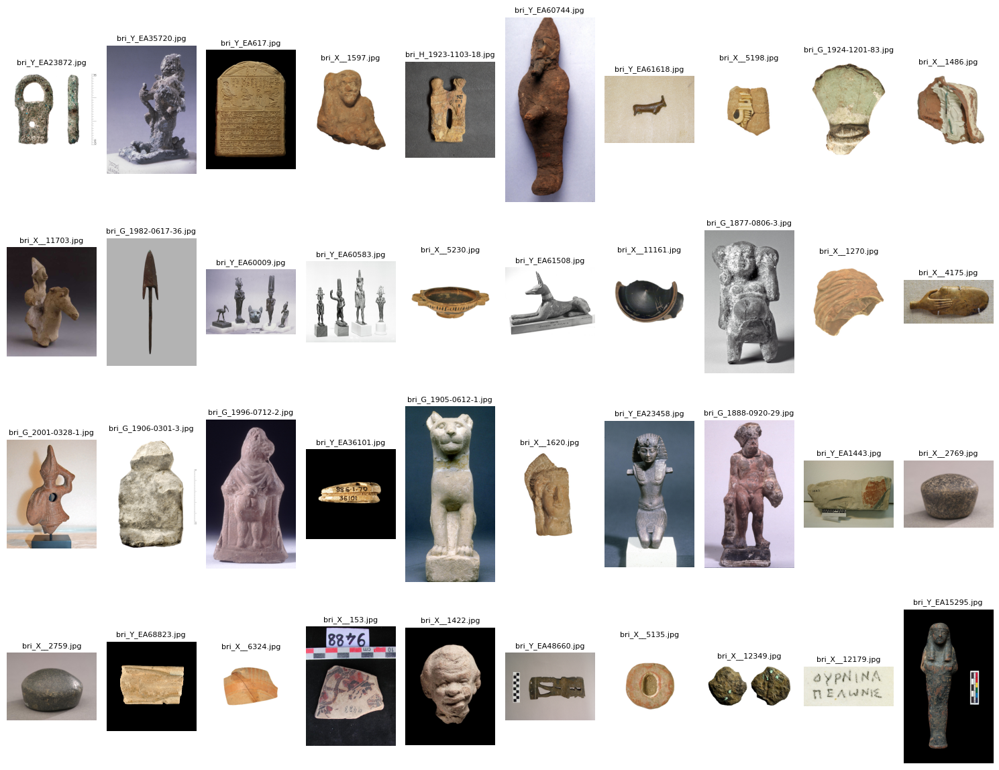

papyrus 2713


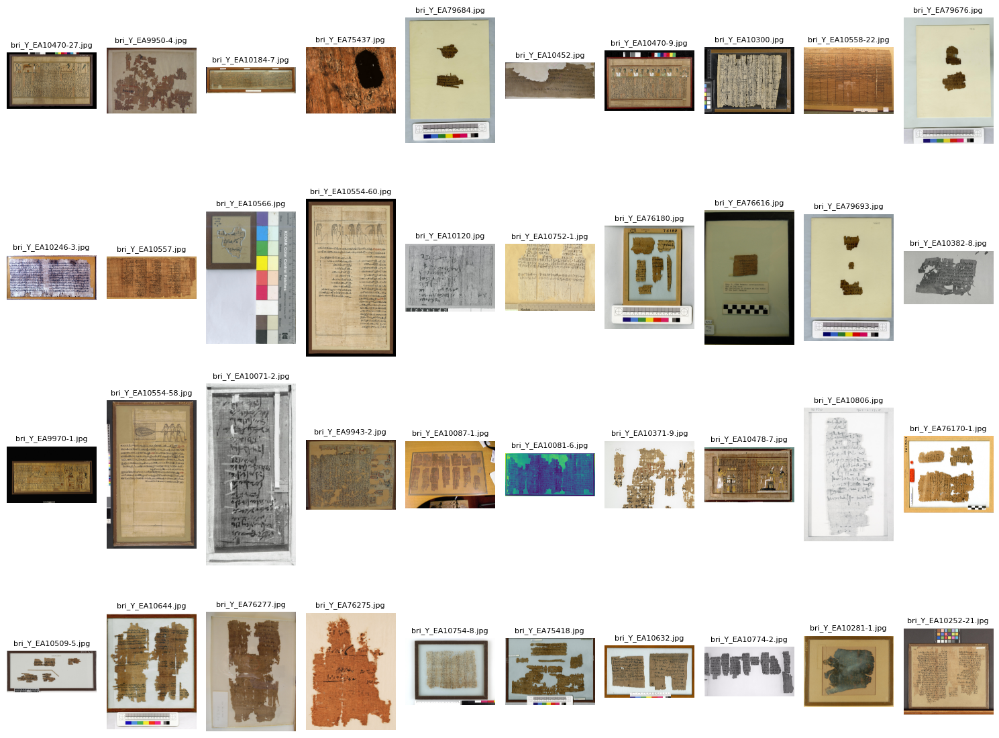

transport amphora 2342


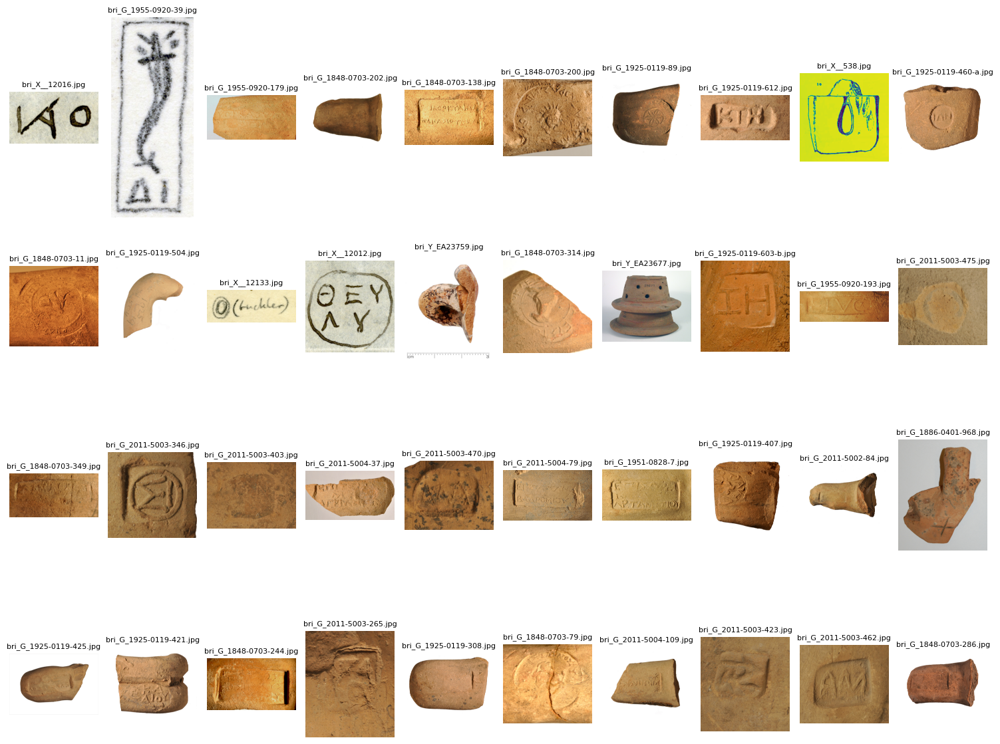

amulet 2176


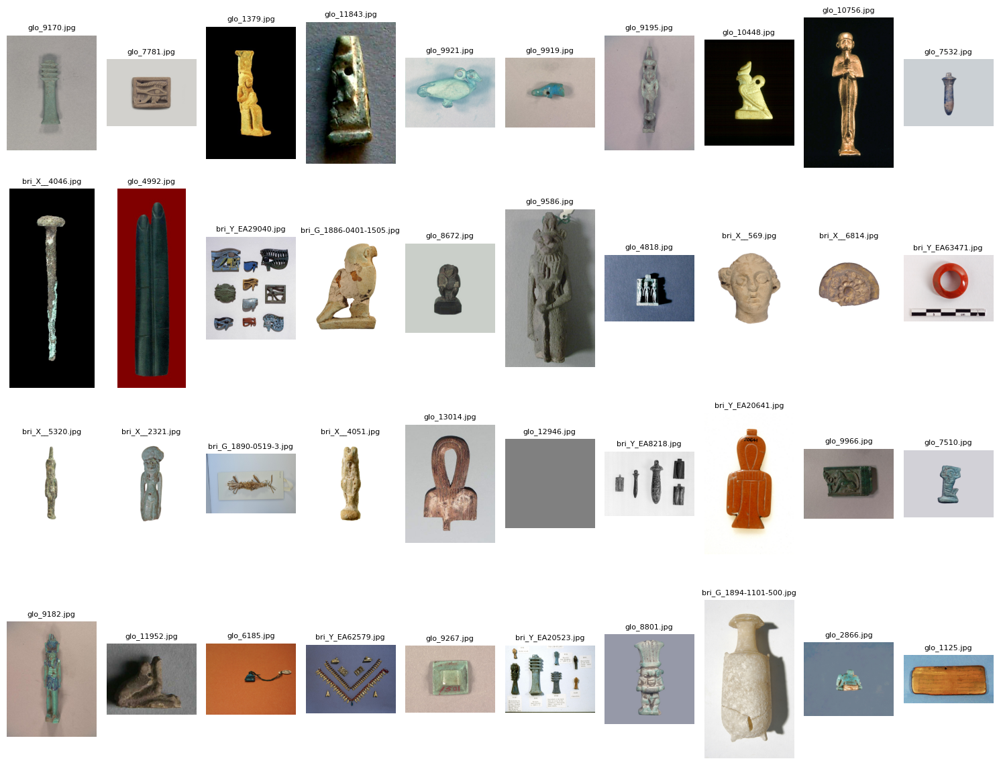

vessel 1965


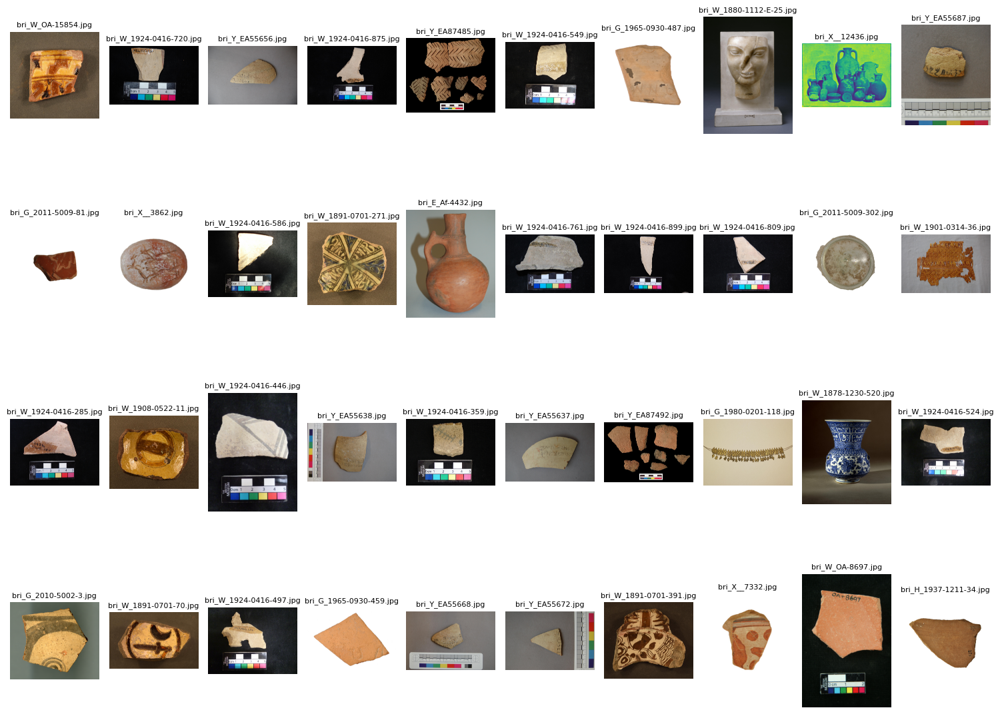

bowl 1694


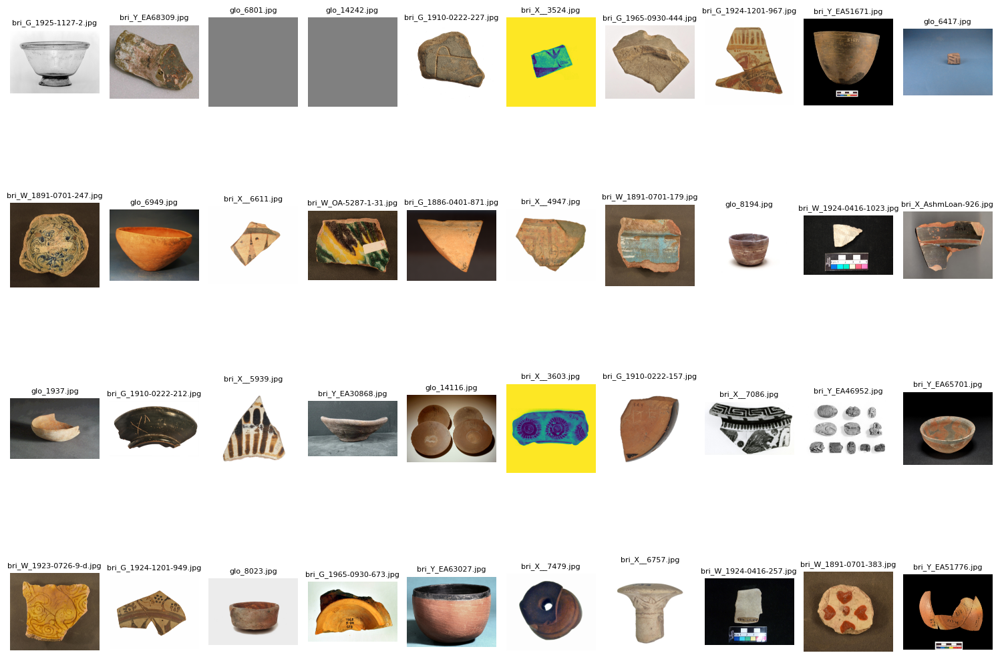

print 1541


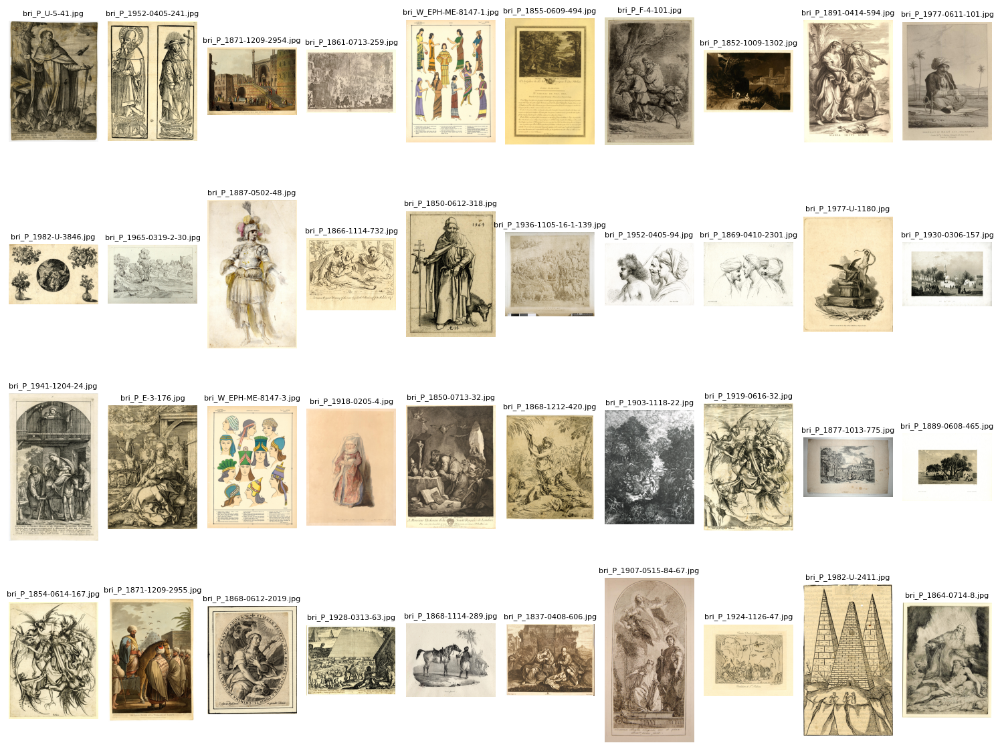

chalice 1468


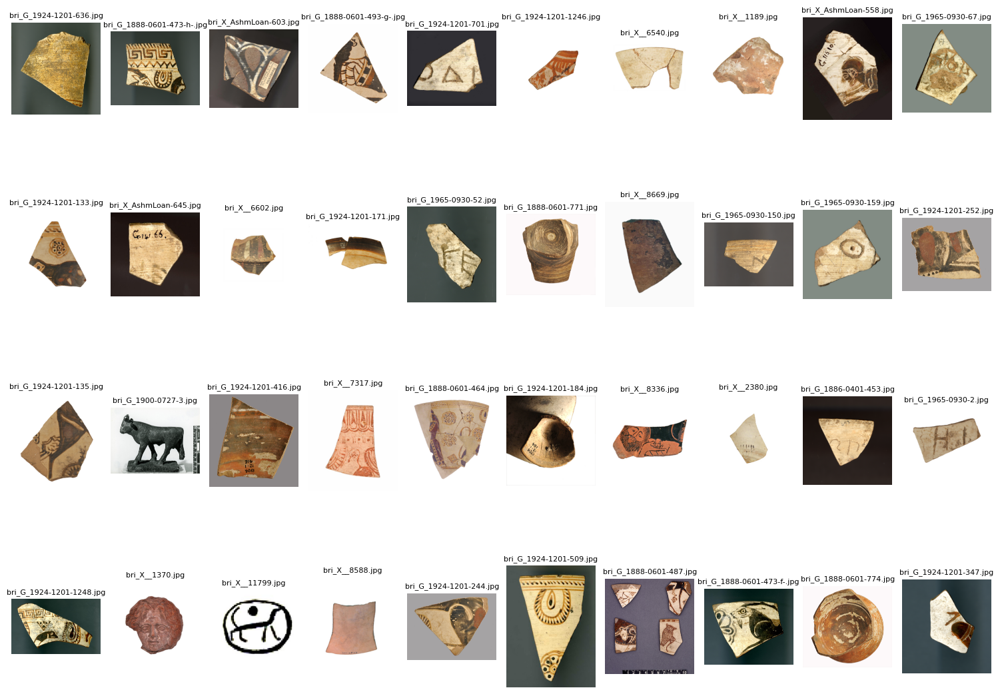

figurine 1455
Error loading image at index 60977: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13726.jpg'
Error loading image at index 60856: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13617.jpg'
Error loading image at index 61015: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13760.jpg'
Error loading image at index 60335: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyp

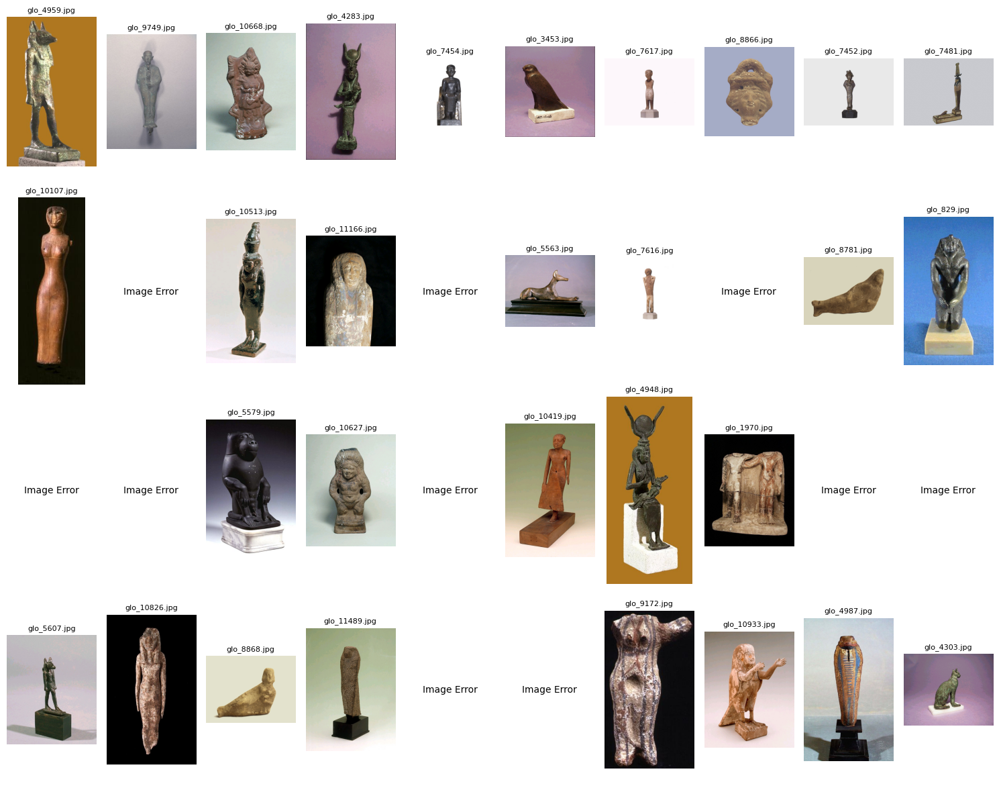

scarab 1409


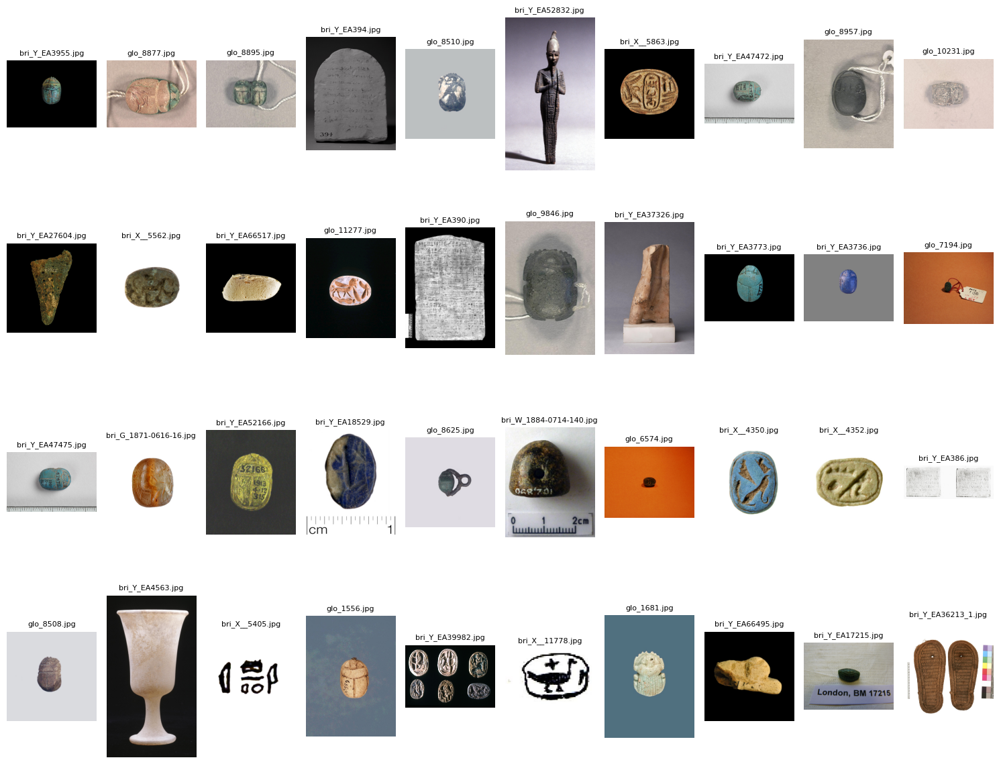

stela 1319


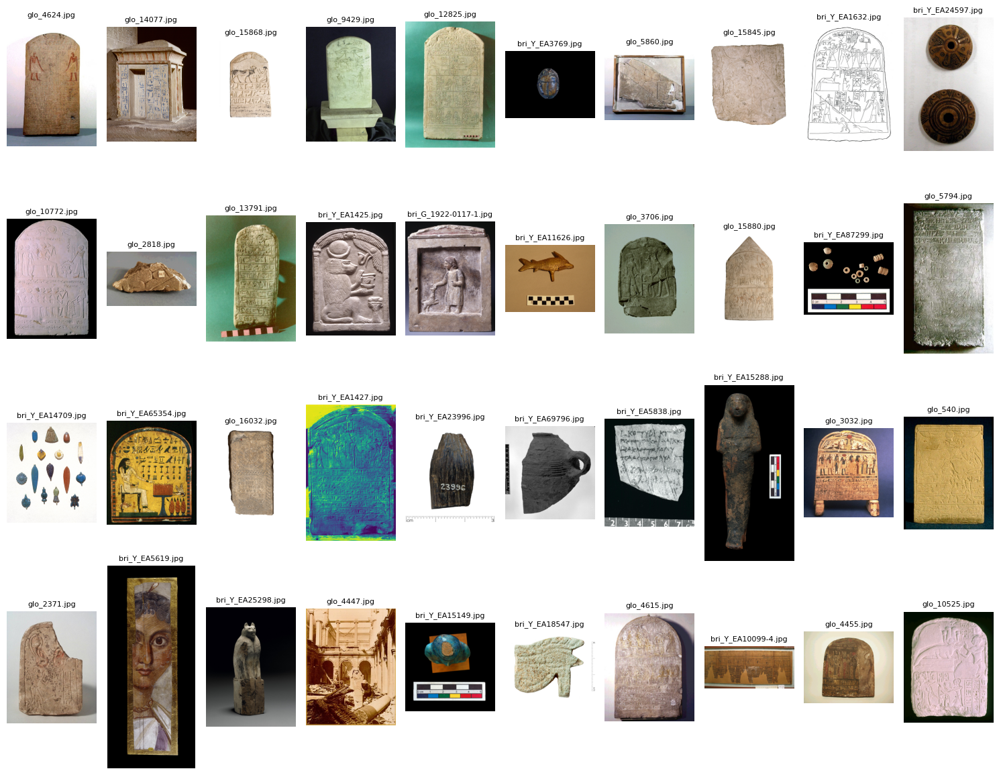

vase 1135
Error loading image at index 60623: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13407.jpg'


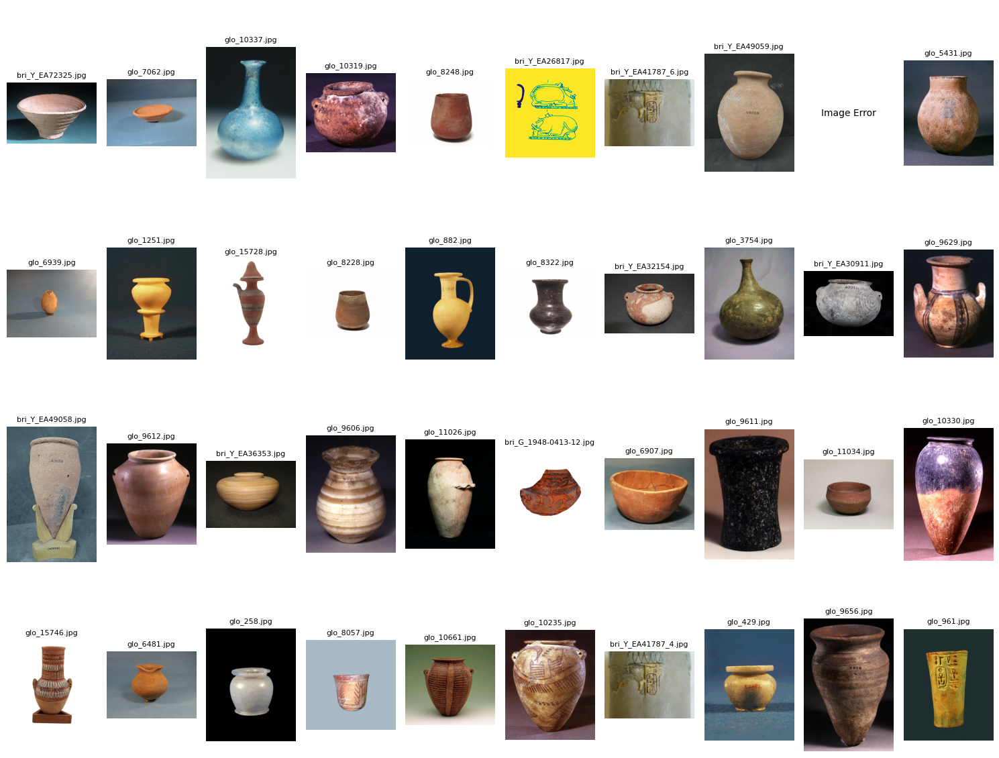

statue 1070
Error loading image at index 60642: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13424.jpg'
Error loading image at index 61010: cannot identify image file 'd:\\My_working_area\\University\\Machine Intelligence\\PROJECT\\GITHUB2\\Museum-Artifacts-Categorization\\ScrappingScripts\\Combining_Museums\\..\\GlobalEgyptianMuseum\\photo\\glo_13756.jpg'


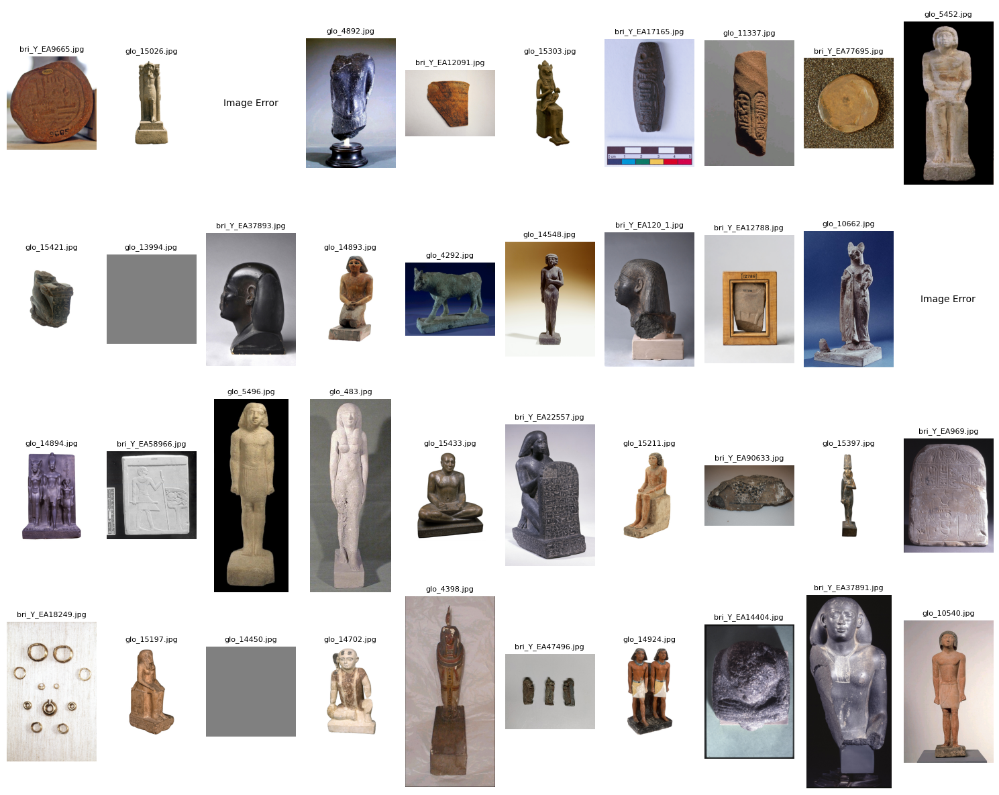

weight 1013


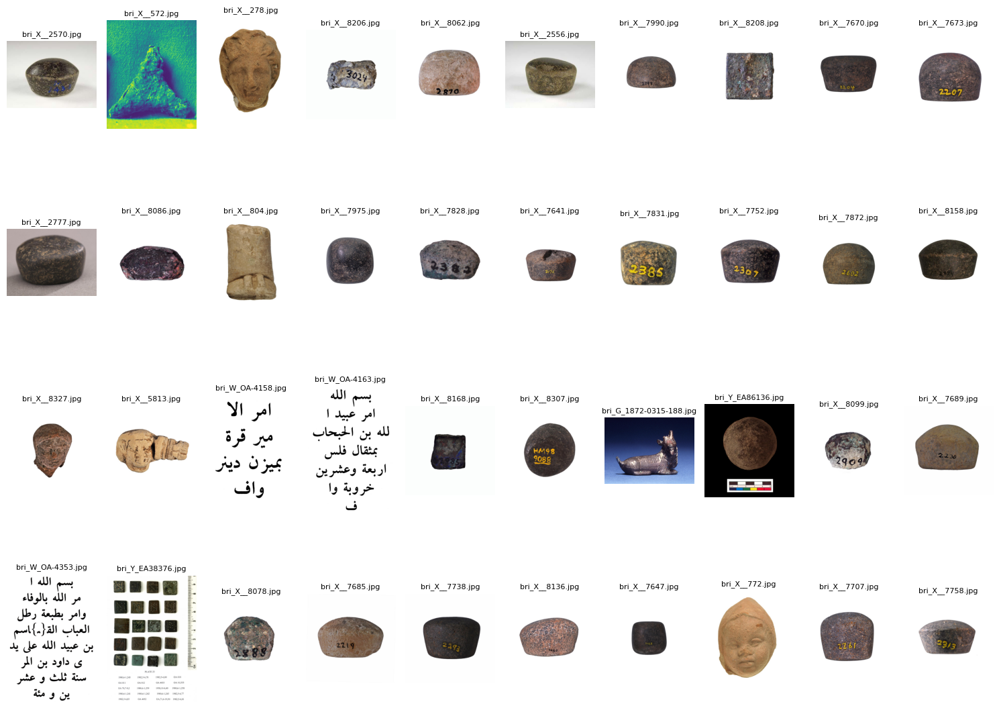

tablet 1004


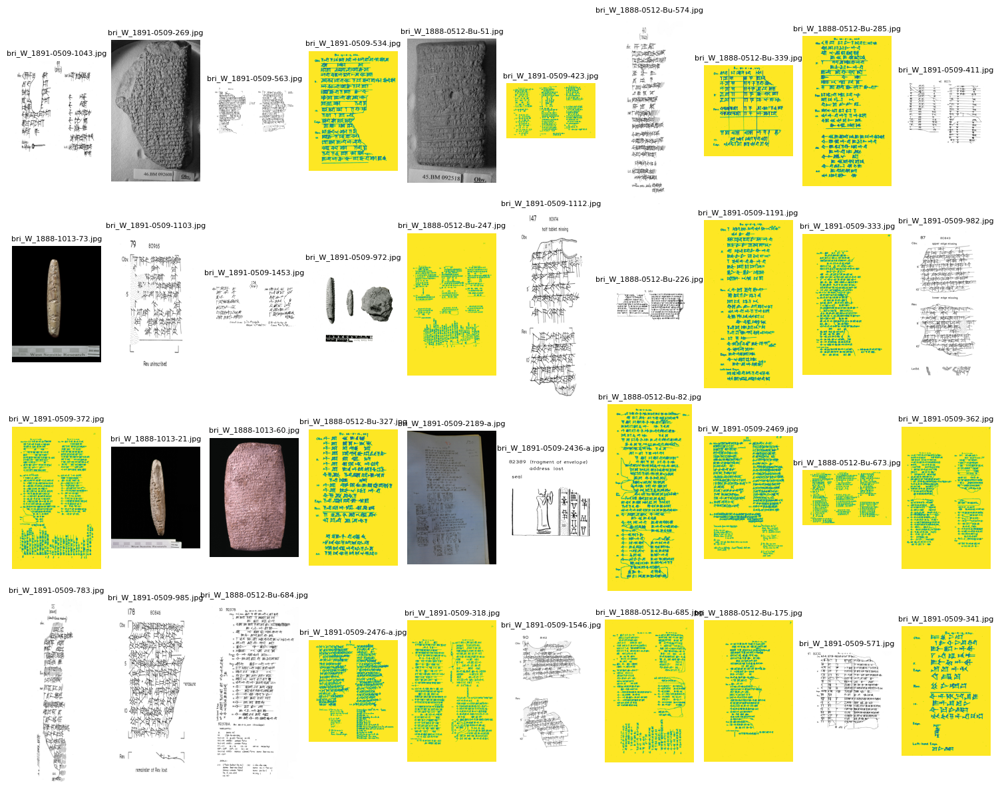

jar 998


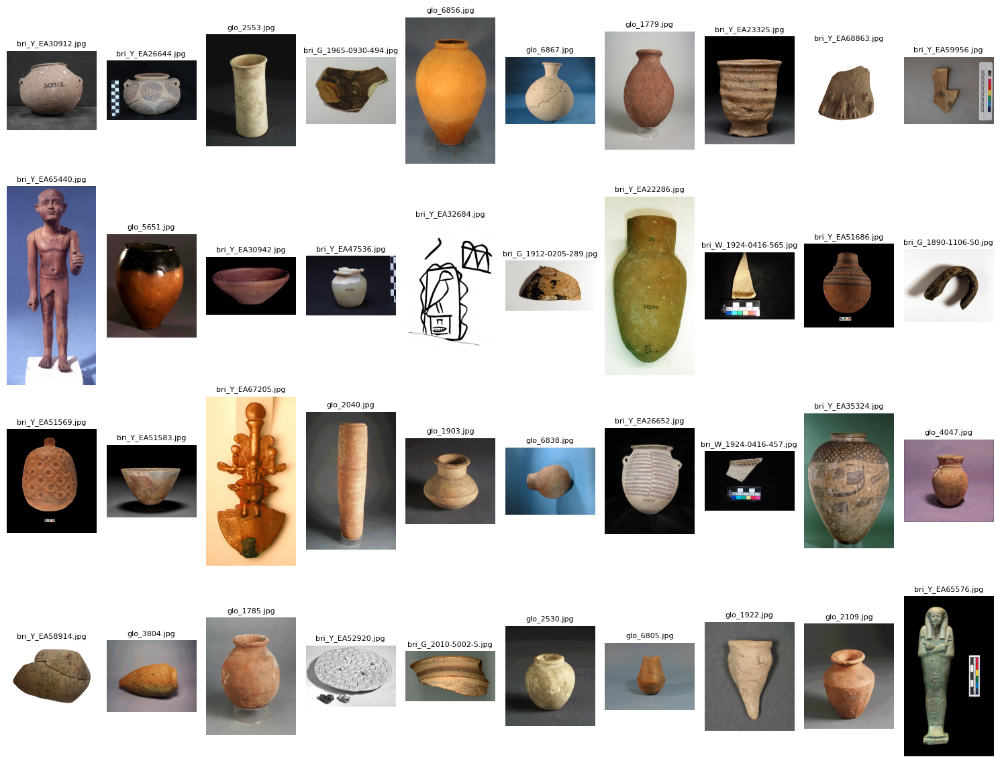

bead 737


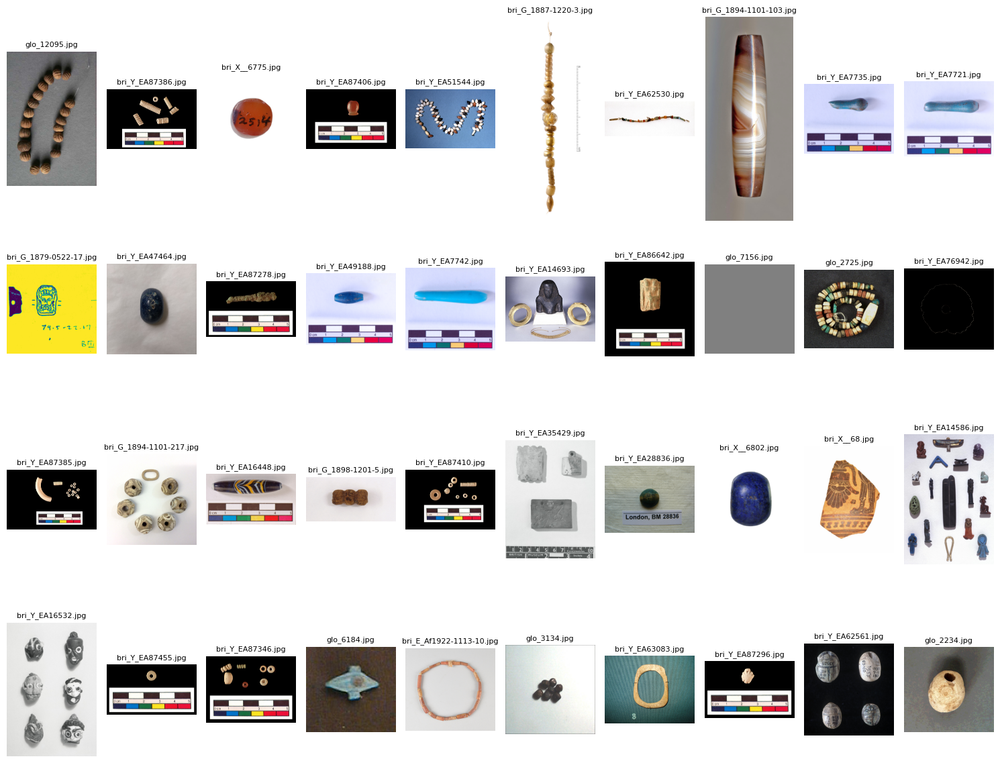

ionian cup 680


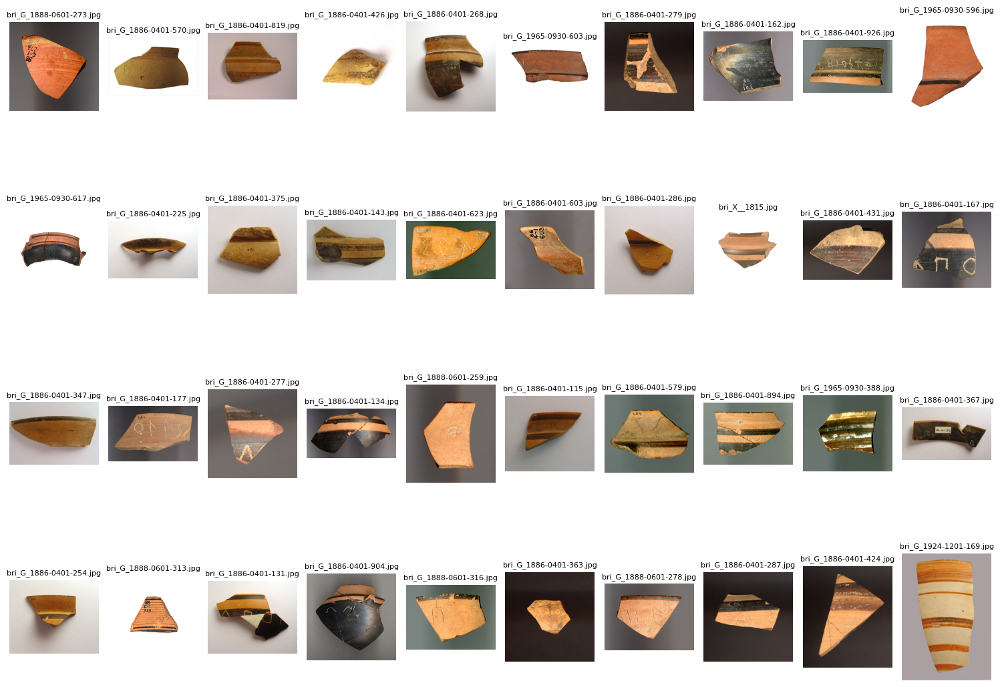

cup 674


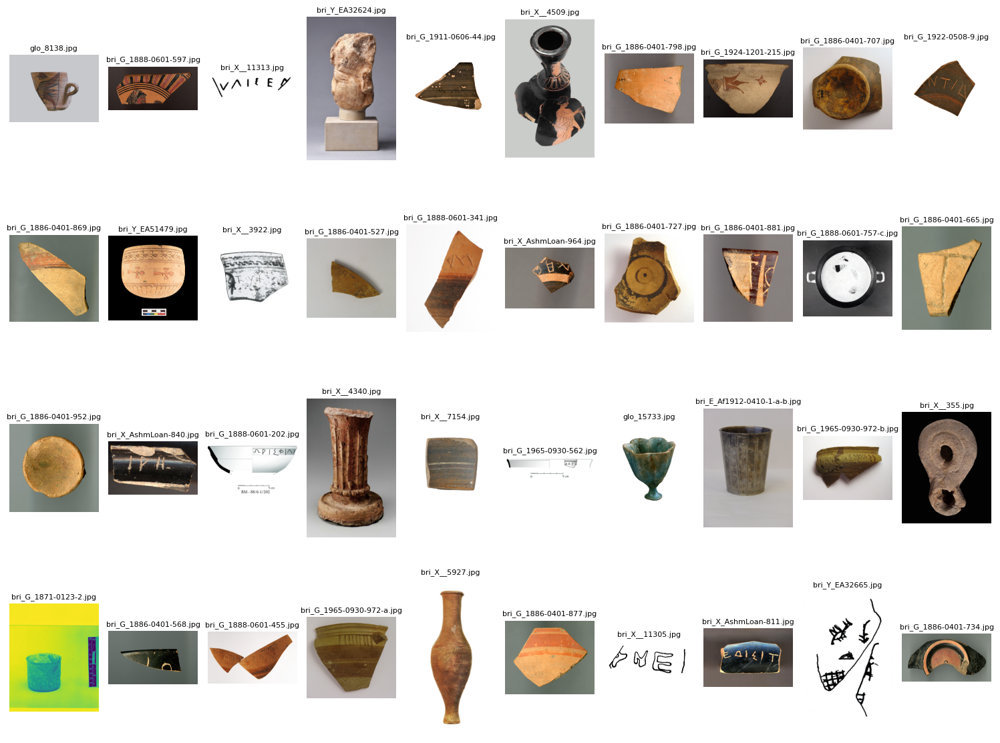

relief 606


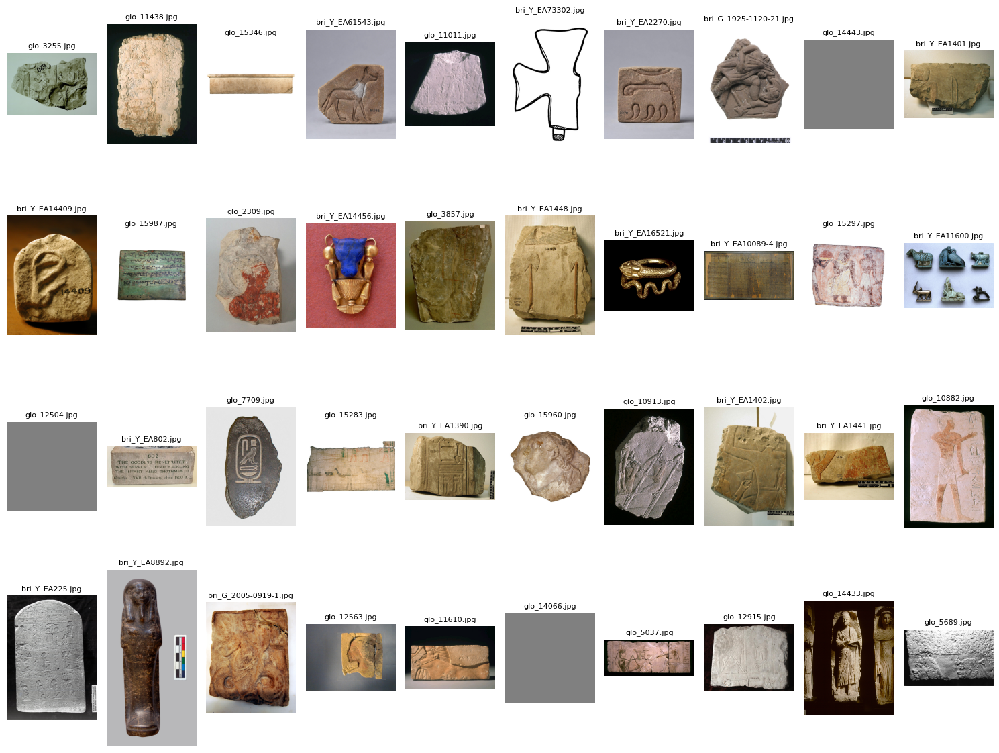

amphora 587


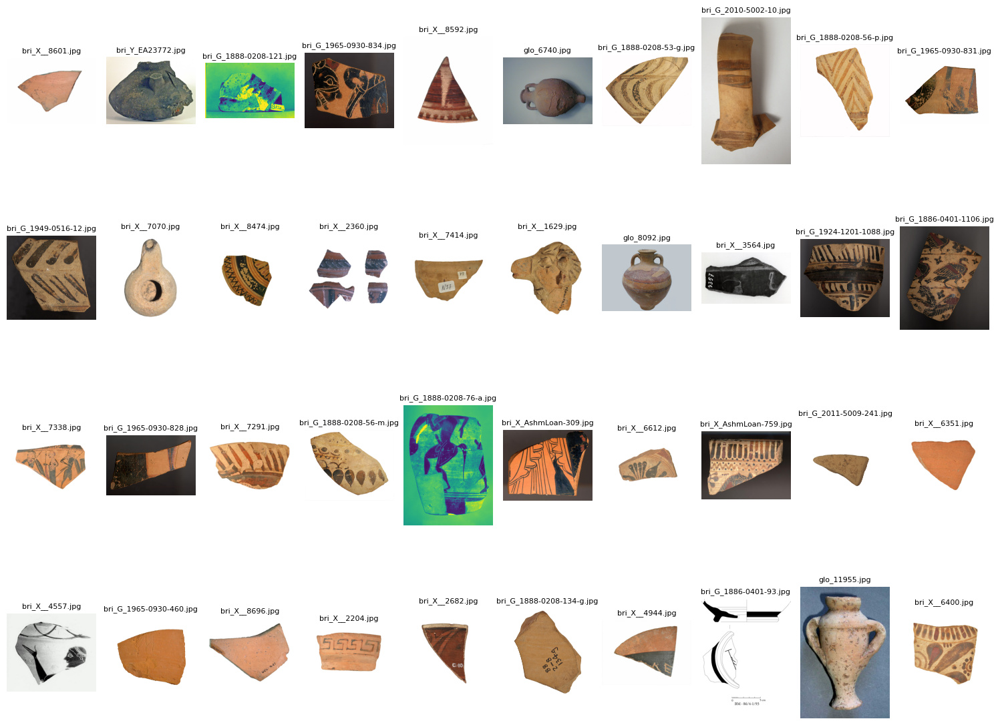

drawing 576


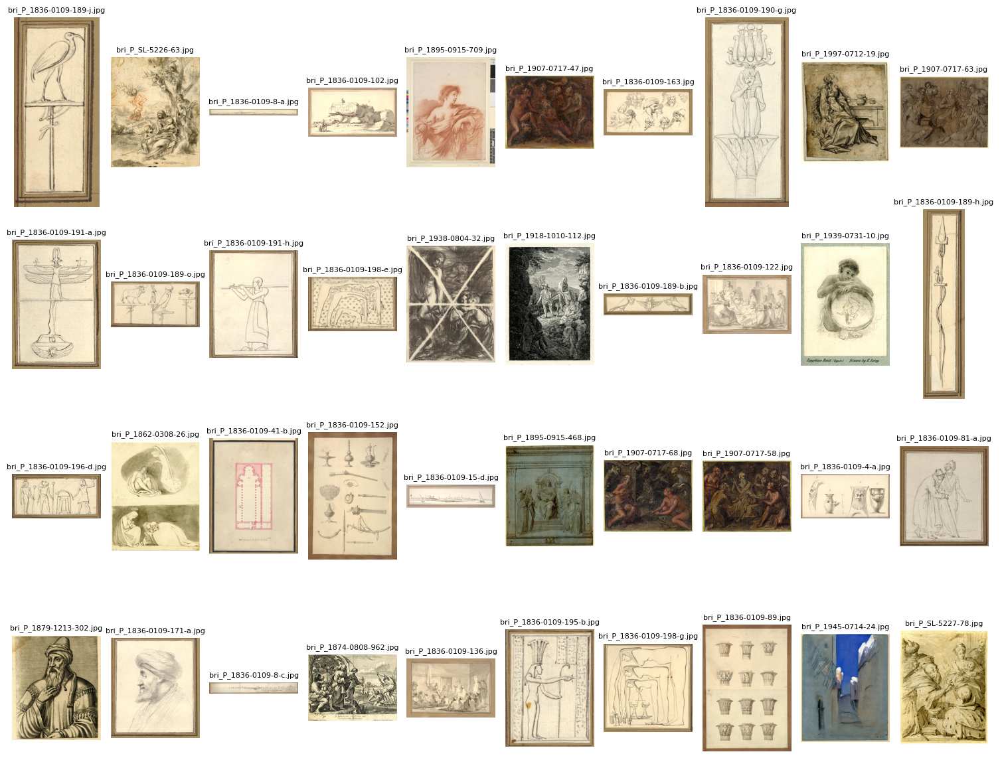

digital photograph 564


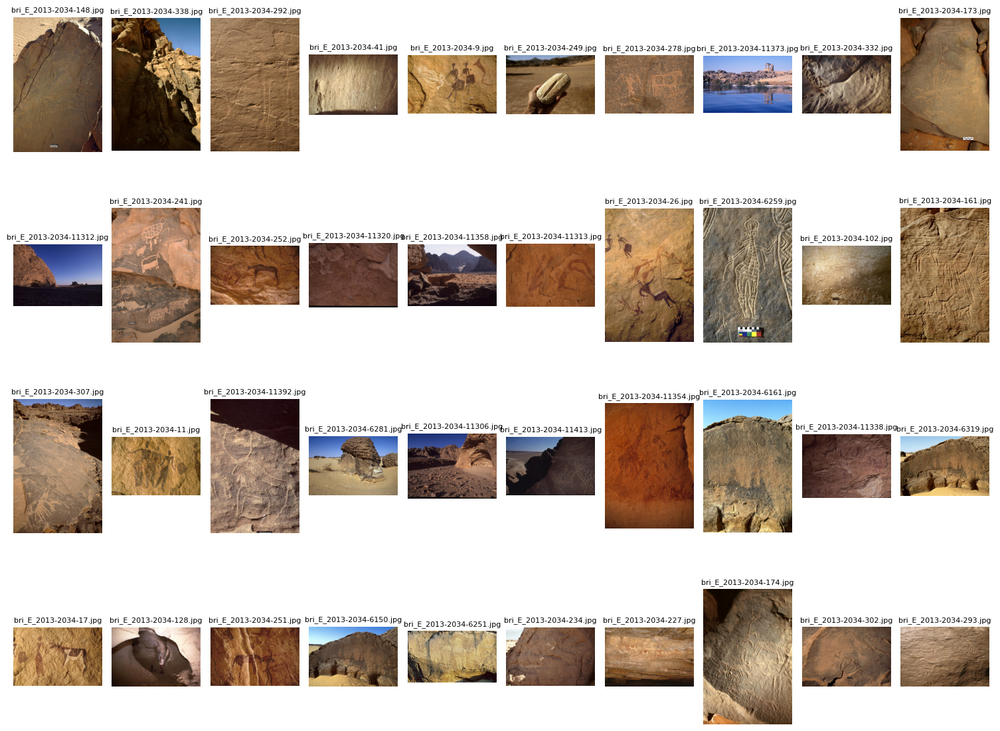

arrow-head 546


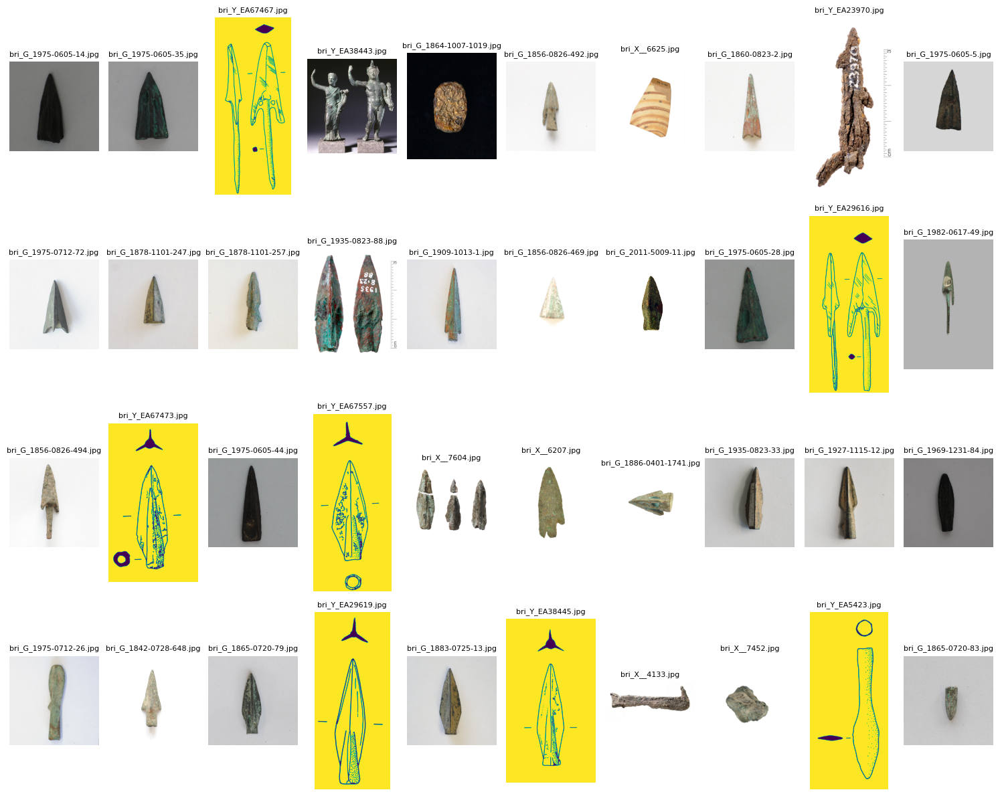

coffin 536


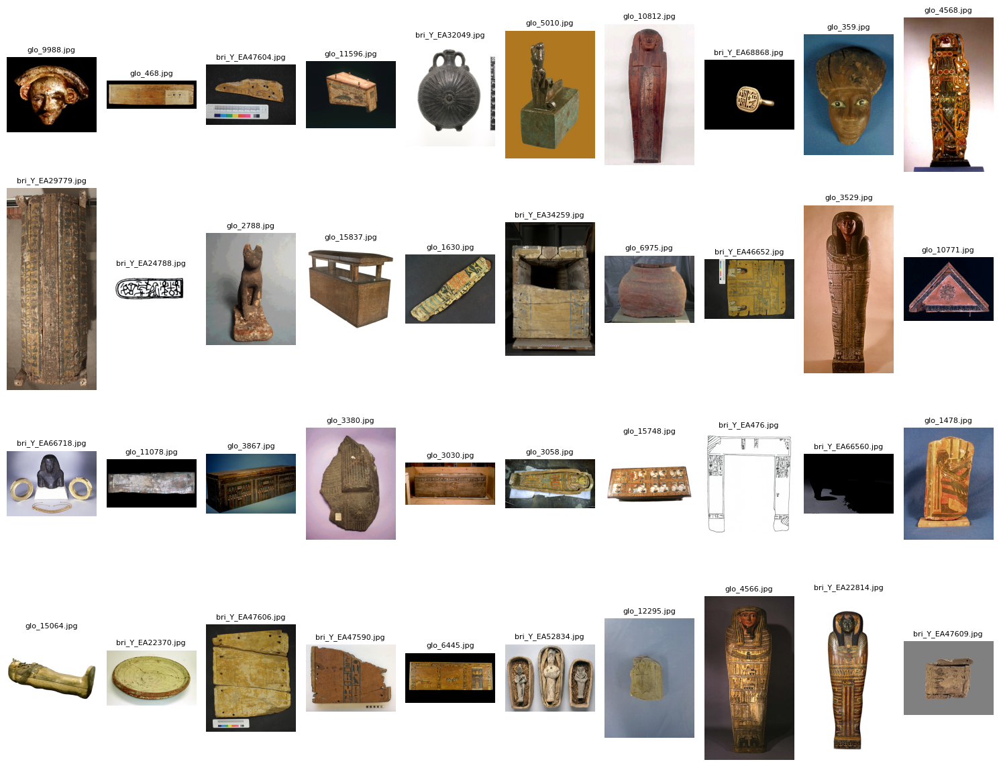

textile 523


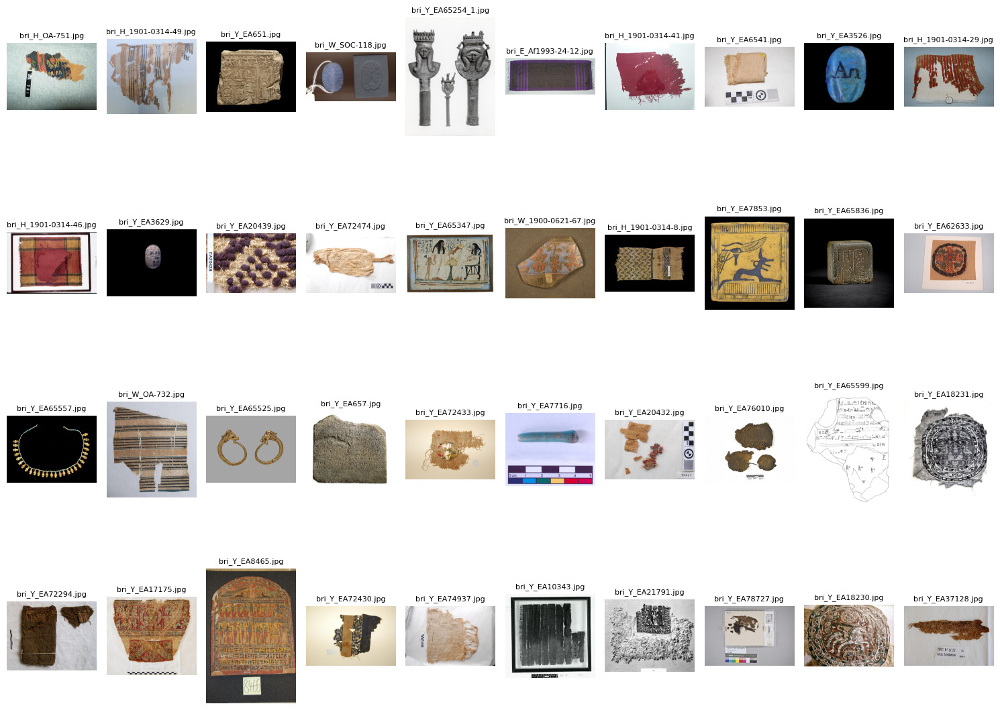

lamp 509


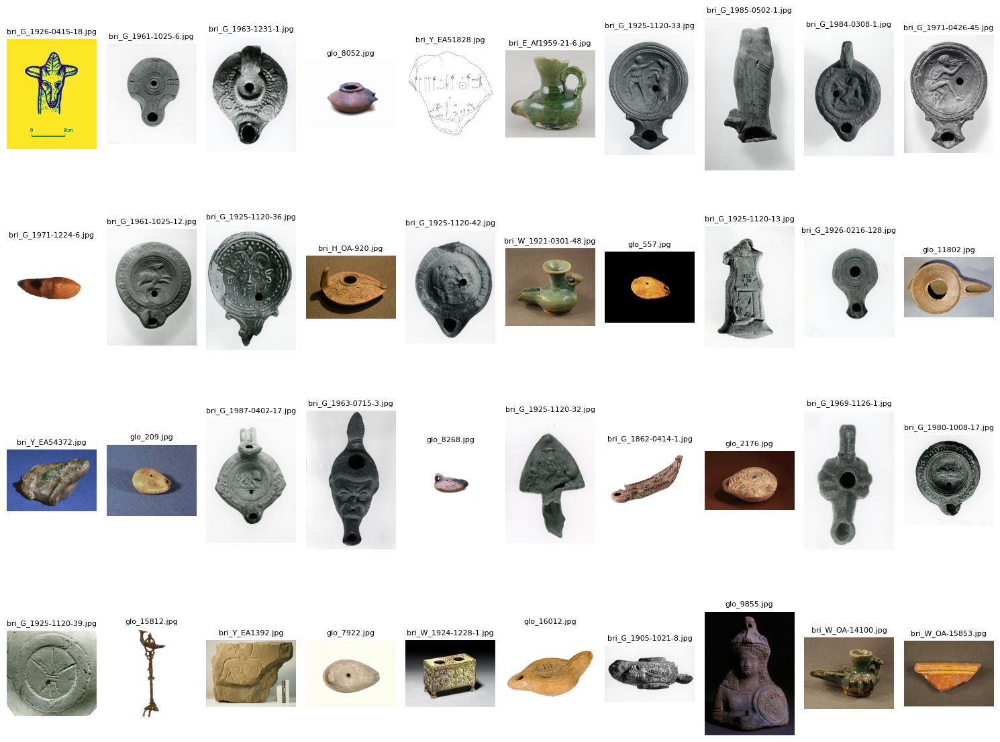

In [92]:
for i in top30_pbject:
    show_images(df,"object_classification", i)

### `Combine similar objects`

In [93]:
top30_pbject

Index(['coin', 'shabti', 'ostracon', 'figure', 'papyrus', 'transport amphora',
       'amulet', 'vessel', 'bowl', 'print', 'chalice', 'figurine', 'scarab',
       'stela', 'vase', 'statue', 'weight', 'tablet', 'jar', 'bead',
       'ionian cup', 'cup', 'relief', 'amphora', 'drawing',
       'digital photograph', 'arrow-head', 'coffin', 'textile', 'lamp'],
      dtype='object', name='object_classification')

In [97]:
combine_values(df, "object_classification", ['ostracon','transport amphora','bowl', 'chalice','ionian cup', 'cup', 'jar', 'amphora', 'vase', 'vessel' ], "vessel") # combined all the items that are like containers
combine_values(df, "object_classification", ['shabti','figure', 'figurine', 'statue' ], "statue") #all are status of faces 
combine_values(df,"object_classification", ['stela','relief','papyrus' ], "inscription" ) #combined all materials that have written text on
combine_values(df, "object_classification", ['print', 'drawing'], "art") # both are art pieces drawn in similar style
combine_values(df, "object_classification", ['amulet', 'scarab', 'bead', 'ear-rings'], "accessories")

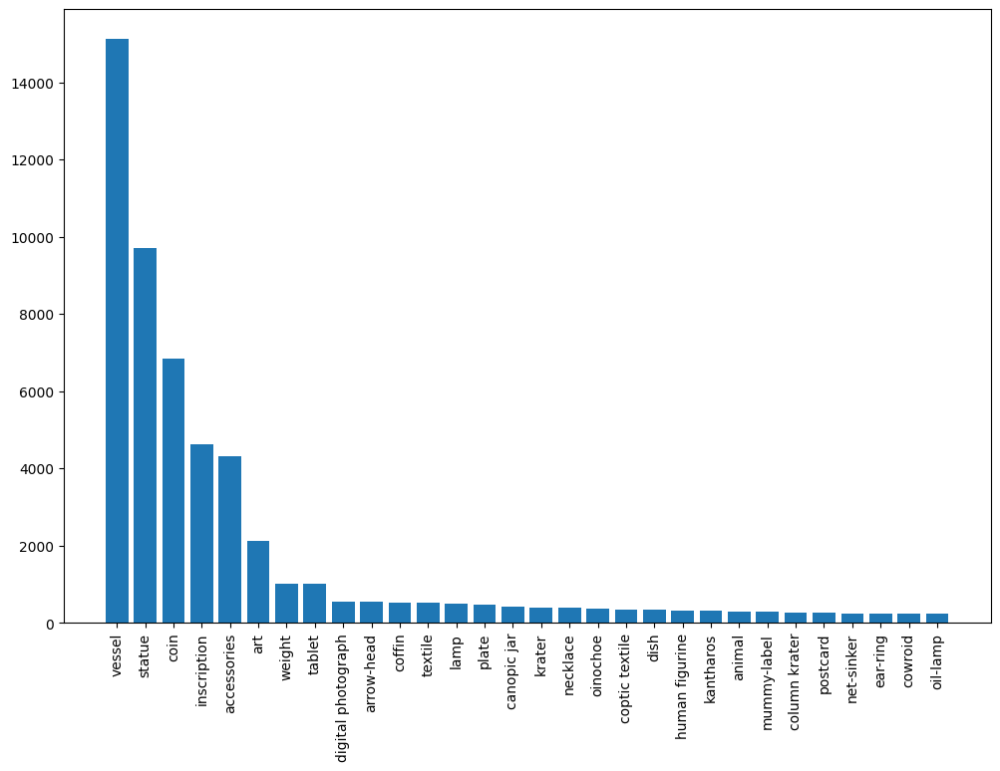

In [98]:
top30_object_new = print_value_count(df, "object_classification", 30)

In [99]:
df.to_csv("cleaned_object_classification.csv")